# Project 1 - Exploring the Fourier transform

### Candidate number

10074

## Contents

Contents

## Packages

In [1]:
# Plotting
import matplotlib.pyplot as plt
import matplotlib.cm as cm

# Math tools
import numpy as np
import scipy as sc

# To read png files
from PIL import Image

## Introduction

In this project we first consider the Fourier Transform of *periodic functions* and *signals*. For a $T=1$-periodic function it suffices to know its values on the interval $\mathbb{T}=[0,1)$. We collect all *square integrable* functions in the set:

$$
    L^2(\mathbb{T}) \overset{\textrm{def}}{=} \left\{ f:\mathbb{T}\rightarrow \mathbb{R} \,\middle\vert\, \int_0^1 |d(t)|^2 dx < \infty \right\}.
$$

We define the *inner product* for $f, g\in \mathbb{T}$ by:

$$
    \langle f, g \rangle = \int_0^1 f(x)\overline{g(x)}dx.
$$

This gives the norm $\lVert f \rVert = \sqrt{\langle f, f \rangle}$.

## Task 1 - The Discrete Fourier Transform

### 1a)

We consider the functions $e^{2\pi kx}, k\in\mathbb{Z}, x\in\mathbb{T}$. 

**Claim:** For any $k, h\in\mathbb{Z}$ we have:

$$
    \langle e^{2\pi i k \cdot}e^{2\pi i h \cdot}\rangle 
    = \begin{cases} 1 & \textrm{if }k=h \\ 0 & \textrm{else.} \end{cases}
$$

**Proof:** We compute:

$$
    \begin{align*} 
        \langle e^{2\pi i k \cdot},e^{2\pi i h \cdot}\rangle 
        &= \int_0^1 e^{2\pi i k x}e^{-2\pi i h x}dx \\
        &= \int_0^1 e^{2\pi i (k-h) x}dx \\
        &= \begin{cases}    \int_0^1 e^0dx & \textrm{if }k=h \\ 
                            \frac{1}{2\pi i (k-h)}\left[e^{2\pi i (k-h) x}\right]_0^1 & \textrm{else} 
            \end{cases} \\
        &= \begin{cases}    1 & \textrm{if }k=h \\ 
                            0 & \textrm{else.} 
            \end{cases}
    \end{align*}
$$

<div style="text-align: right"> ▢ </div>

### 1b)

We consider the following functions from $\mathbb{T}$:

$$
\begin{align*}
    &\sqrt{2}\sin{(2\pi m x)}, m=1,2,\dots, \\
    &1=\cos{(2\pi 0 x)}, \\
    &\sqrt{2}\cos{(2\pi n x)}, n=1,2,\dots. \\
\end{align*}
$$

**Claim:** The above functions form an orthonormal system

**Recall:** In our proof we will need the following tools:

$$
\begin{align*}
    \sin(a \pm b )
    &=\sin a \cos b \pm \cos a \sin b \\

    \cos(a \pm b ) 
    &=\cos a \cos b \mp \sin a \sin b 
\end{align*}
$$

From wich we have:

$$
\begin{align*}
    \sin a\sin b
    &= \frac{1}{2} (\cos(a-b) - \cos(a+b)) \\

    \sin a\cos b
    &= \frac{1}{2} (\sin(a-b) + \sin(a+b)) \\

    \cos a\cos b
    &= \frac{1}{2} (\cos(a-b) + \cos(a+b)) \\

\end{align*}
$$

**Proof:** We compute:

For $n\in\{1, 2, \dots\}$ and $m\in\{0, 1, \dots\}$ we have:

$$
    \begin{align*} 
        \langle \sqrt{2}\sin{(2\pi n\cdot)}, \sqrt{2}\cos{(2\pi m\cdot)}\rangle 
        &= 2\int_0^1\sin{(2\pi nx)}\cos{(2\pi mx)}dx \\
        &= 2\int_0^1\frac{1}{2}(\sin{(2\pi nx-2\pi mx)}+\sin{(2\pi nx+2\pi mx)})dx \\
        &= \begin{cases}    
        
            \int_0^1\sin{(2\pi (n-m)x)}+\sin{(2\pi (n+m)x)}dx 
            & \textrm{if }m\ne n \\ 
            
            \int_0^1\sin{0}+\sin{(4\pi nx)}dx 
            & \textrm{if } m=n 
            \end{cases} \\
        &= 0.
    \end{align*}
$$

In the last equality we relise that we are integrating $\sin$ over a multiple of it's period to get 0. Similarly for $n,m\in\{1, 2, \dots\}$ we have:

$$
    \begin{align*} 
        \langle \sqrt{2}\sin{(2\pi n\cdot)}, \sqrt{2}\sin{(2\pi m\cdot)}\rangle 
        &= 2\int_0^1\sin{(2\pi nx)}\sin{(2\pi mx)}dx \\
        &= 2\int_0^1\frac{1}{2}(\cos{(2\pi nx-2\pi mx)}-\cos{(2\pi nx+2\pi mx)})dx \\
        &= \begin{cases}    
        
            \int_0^1\cos{(2\pi (n-m)x)}-\cos{(2\pi (n+m)x)}dx 
            & \textrm{if }m\ne n \\ 
            
            \int_0^1\cos{0}+\cos{(4\pi nx)}dx 
            & \textrm{if } m=n 
            \end{cases} \\
        &= \begin{cases}    
        
            0 & \textrm{if }m\ne n \\ 
            
            1 & \textrm{if }m=n. 
            \end{cases} 
    \end{align*}
$$

Again we integrate $\cos$ over some multiple of its period. This time we get $1$ in the bottom case since $\cos{0}=1$. Finally, for $n,m\in\{1, 2, \dots\}$

$$
    \begin{align*} 
        \langle \sqrt{2}\cos{(2\pi n\cdot)}, \sqrt{2}\cos{(2\pi m\cdot)}\rangle 
        &= 2\int_0^1\cos{(2\pi nx)}\cos{(2\pi mx)}dx \\
        &= 2\int_0^1\frac{1}{2}(\cos{(2\pi nx-2\pi mx)}+\cos{(2\pi nx+2\pi mx)})dx \\
        &= \begin{cases}    
        
            \int_0^1\cos{(2\pi (n-m)x)}+\cos{(2\pi (n+m)x)}dx 
            & \textrm{if }m\ne n \\ 
            
            \int_0^1\cos{0}+\cos{(4\pi nx)}dx 
            & \textrm{if } m=n\ne0 \\
            
            \int_0^1\cos{0}+\cos{0}dx 
            & \textrm{if } m=n=0
            
            \end{cases} \\
        &= \begin{cases}    
        
            0 & \textrm{if }m\ne n \\ 
            
            1 & \textrm{if }m=n\ne0 \\
            
            2 & \textrm{if }m=n=0. 
            \end{cases} 
    \end{align*}
$$

Again we integrate over periods. We get at additional case since we can have $m=n=0$. In the previous calculation we had $m, n \geq1$.

Note that by the sesquilinearity of the inner product, we can take out $\sqrt{2}$ when $n=0$ or $m=0$ to obtain the desired result for the inner products with the element $1$. For instance:

$$
    \langle 1, 1\rangle = \frac{1}{2}  \langle \sqrt{2} \cos(0), \sqrt{2}\cos(0)\rangle = 1. 
$$

<div style="text-align: right"> ▢ </div>

### 1c)

We introduce the following spaces:

$$
\begin{align*}
    \mathcal{T}_n &\overset{\textrm{def}}{=} 
        \textrm{span}(e^{-2\pi i n \cdot}, \dots, e^{2\pi i n \cdot})\\
        &=\left\{ f \vert f(x)=\sum_{k=-n}^{n} c_ke^{2\pi i k x}, \textrm{ where }c_i\in \mathbb{C} \textrm{ and } c_k=\overline{c_{-k}}\right\}, \\

    \mathcal{S}_n &\overset{\textrm{def}}{=} 
        \textrm{span}(\cos(0\cdot), \cos(2\pi\cdot),\dots,\cos(2\pi n\cdot), \sin(2\pi\cdot), \dots \sin(2\pi n \cdot)) \\
        &=\left\{ f \vert f(x)=\frac{a_0}{2} + \sum_{k=1}^{n} a_k \cos(2\pi k x)+ b_k\sin(2\pi k x), 
        \textrm{ where }a_i, b_j \in \mathbb{R} \right\}.

\end{align*}
$$

**Orthonormal bases**

From a) we have that $e^{-2\pi i n \cdot}, \dots, e^{2\pi i n \cdot}$ form an orthonormal basis for $\mathcal{T}_n$. We have shown orthonormality wich implies linear independence. By the definition of $\mathcal{T}_n$ the set is clearly spanning.

From b) we have that $\cos(0\cdot), \sqrt{2}\cos(2\pi\cdot),\dots,\sqrt{2}\cos(2\pi n\cdot), \sqrt{2}\sin(2\pi\cdot), \dots \sqrt{2}\sin(2\pi n \cdot)$ forms an orthonormal basis for $\mathcal{S}_n$. Again linear independence follows from orthonormality and spanning is clear:

$$
\begin{align*}
    f(x) 
    
    &= \frac{a_0}{2} + \sum_{k=1}^{n} a_k \cos(2\pi k x)+ b_k\cos(2\pi k x) \\

    &= \frac{a_0}{2}\cdot \cos(0) + \sum_{k=1}^{n} \frac{a_k}{\sqrt{2}}\cdot\sqrt{2} \cos(2\pi k x)+ \frac{b_k}{\sqrt{2}}\cdot\sqrt{2}\cos(2\pi k x).
\end{align*}
$$

**Equality of the spaces**

We prove that $\mathcal{T}_n = \mathcal{S}_n$ by proving both inclusions.

*Proof of* $\mathcal{T}_n \subseteq \mathcal{S}_n$:

Assume $f\in \mathcal{T}_n$. Then:

$$
\begin{align*}
    f(x)
    &= \sum_{k=-n}^{n} c_ke^{2\pi i k x} \\

    &= \sum_{k=-n}^{n} c_k \cos(2\pi k x) + i c_k \sin(2\pi k x) \\

    &= c_0 \cos(0) + i c_0 \sin(0) + 
    \sum_{k=1}^{n} c_k \cos(2\pi k x) + i c_k \sin(2\pi k x) + c_k \cos(2\pi (- k) x) + i c_k \sin(2\pi (-k) x) \\

    &= c_0 + \sum_{k=1}^{n} \overset{2\textrm{Re }c_k}{\overbrace{(c_k+c_{-k})}} \cos(2\pi k x) + i \overset{2i\textrm{Im }c_k}{\overbrace{(c_k-c_{-k})}} \sin(2\pi k x)

    \in \mathcal{S}_n
\end{align*}
$$

Where in the final equality we found that both sum of coefficients and $i$ times the difference gives a real number due to the condition $c_k = \overline{c_{-k}}$.

<div style="text-align: right"> ▢ </div>

*Proof of* $\mathcal{S}_n \subseteq \mathcal{T}_n$:

Assume $f\in \mathcal{S}_n$. Then, using the complex definitions of sine and cosine we obtain:

$$
\begin{align*}
    f(x)
    &= \frac{a_0}{2} + \sum_{k=1}^{n} a_k \cos(2\pi k x)+ b_k\sin(2\pi k x) \\

    &= \frac{a_0}{2} + \sum_{k=1}^{n} \frac{a_k}{2} (e^{2\pi i k x} + e^{-2\pi i k x})
    + \frac{b_k}{2i}(e^{2\pi i k x} - e^{-2\pi i k x}) \\

    &= \frac{a_0}{2} e^0 + \sum_{\substack{k=-n \\ k \ne 0}}^{n} 
    \frac{a_{|k|}}{2} e^{2\pi i k x} + \textrm{sgn}(k)\frac{b_{|k|}}{2i}e^{2\pi i k x} \\

    &= \sum_{\substack{k=-n}}^{n} 
    \overset{c_k}{\overbrace{\left(\frac{a_{|k|}}{2} - \textrm{sgn}(k)\frac{b_{|k|}}{2}i\right)}}
    e^{2\pi i k x} 

    \in \mathcal{T}_n
\end{align*}
$$

Here we defined $\textrm{sgn}(k)$ to be the sign of $k$ (0 if $k=0$). We could conclude with inclusion in $\mathcal{T}_n$ as the coefficients $c_k$ satisfy:

$$
\begin{align*}
    c_k &= \frac{a_{|k|}}{2} - \textrm{sgn}(k)\frac{b_{|k|}}{2}i \\

    &= \frac{a_{|-k|}}{2} + \textrm{sgn}(-k)\frac{b_{|-k|}}{2}i = \overline{c_{ik}}.
\end{align*}
$$

<div style="text-align: right"> ▢ </div>

**Dimension of $\mathcal{T}_n$**

We recall that the dimension of a vector space equals the dimension of a basis for it. In this case we have:

$$
    \dim \mathcal{T}_n = \dim \mathcal{S}_n = 2n+1.
$$

### 1d) 

**Claim:** The Fourier coefficients of $f\in \mathcal{S}_n$ can be computed as:

$$
\begin{align*}
    a_k &= 2\langle f, \cos(2\pi k \cdot) \rangle = 2\int_{-\frac{1}{2}}^{\frac{1}{2}}f(x)\cos(2\pi k x) dx,\quad k=0,1,\dots, n, \\

    b_k &= 2\langle f, \sin(2\pi k \cdot) \rangle = 2\int_{-\frac{1}{2}}^{\frac{1}{2}}f(x)\sin(2\pi k x) dx,\quad k=1,\dots, n.
\end{align*}
$$

**Proof:**

For the first we have:

$$
\begin{align*}
  2\langle f, \cos(2\pi k \cdot) \rangle 
  
  &= 2 \langle \frac{a_0}{2} + \sum_{j=1}^{n} a_k \cos(2\pi j \cdot)+ b_k\sin(2\pi j \cdot), \cos(2\pi k \cdot) \rangle \\

  &= \frac{a_0}{2} \overset{2 \textrm{ if } k = 0, \, 0 \textrm{ otherwise}}{\overbrace{\langle \sqrt{2}, \sqrt{2}\cos(2\pi k \cdot) \rangle}} + 
  \sum_{j=1}^{n} 
  a_k \overset{1 \textrm{ if } j = k, \, 0 \textrm{ otherwise}}{\overbrace{\langle  \sqrt{2}\cos(2\pi j \cdot), \sqrt{2}\cos(2\pi k \cdot) \rangle}} + 
  b_k \overset{0}{\overbrace{\langle  \sqrt{2}\sin(2\pi j \cdot), \sqrt{2}\cos(2\pi k \cdot) \rangle}} \\

  &= a_k.

\end{align*}
$$

Similarly:

$$
\begin{align*}
  2\langle f, \sin(2\pi k \cdot) \rangle 
  
  &= 2 \langle \frac{a_0}{2} + \sum_{j=1}^{n} a_k \cos(2\pi j \cdot)+ b_k\sin(2\pi j \cdot), \sin(2\pi k \cdot) \rangle \\

  &= \frac{a_0}{2} \overset{0}{\overbrace{\langle \sqrt{2}, \sqrt{2}\sin(2\pi k \cdot) \rangle}} + 
  \sum_{j=1}^{n} 
  a_k \overset{0}{\overbrace{\langle  \sqrt{2}\cos(2\pi j \cdot), \sqrt{2}\sin(2\pi k \cdot) \rangle}} + 
  b_k \overset{1 \textrm{ if } j = k, \, 0 \textrm{ otherwise}}{\overbrace{\langle  \sqrt{2}\sin(2\pi j \cdot), \sqrt{2}\sin(2\pi k \cdot) \rangle}} \\

  &= a_k.
\end{align*}
$$

Note that in the claim the bounds of the integrals in the inner product are translated, which works because we still integrate over a period. (Product of two $T=1$-periodic functions is still $T=1$-periodic).

<div style="text-align: right"> ▢ </div>

### 1e) 

We want to approximate the integral in the Fourier coefficients $c_k(f)$ by using the composite trapezoidal rule with $N\in\mathbb{N}$ equidistant points $x_0, \dots, x_{N-1}$ where $x_j=\frac{j}{N}$. For brevity we denote $f_j=f(x_j)$ and $\boldsymbol{f}=(f_0, ..., f_{N-1})$.

**Deduction of approximation**

The expression for $c_k(f)$ is:

$$
    c_k(f) = \langle f, e^{2\pi k i \cdot}\rangle = \int_0^1 f(x) e^{-2\pi k i x}dx
$$

The composite trapezoidal rule reads:

$$
\begin{align*}
    \hat{f}_k &\overset{\textrm{def}}{=}
    \sum_{j=0}^{N-1} \frac{1}{2}(f_{j+1}e^{-2\pi k i x_{j+1}}+f_je^{2\pi j i x_k})\overset{\frac{1}{N}}{\overbrace{(x_{j+1}-x_j)}} \\
    
    &=\frac{1}{2N}(f_0e^{2\pi k i 0}+2f_1e^{2\pi k i \frac{1}{N}}+2f_2e^{2\pi k i \frac{2}{N}}+
    \dots+2f_{N-1}e^{2\pi ki\frac{N-1}{N}}+f_0e^{2\pi k i 1})\\
    
    &=\frac{1}{N}\sum_{j=0}^{N-1} f_je^{-2\pi jik/N}.
\end{align*}
$$

We have used that $f_N=f(x_N)=f(\frac{N}{N})=f(1)=f(0)=f_0$.

**Periodicity of the $\hat{f}_k$'s:** 

The $\hat{f}_k$ are $N$-periodic, that is $\hat{f}_k=\hat{f}_{k+N}$ for all $k\in\mathbb{Z}$:

$$
\begin{align*}
    \hat{f}_{k+N} 
    
    &=\frac{1}{N}\sum_{j=0}^{N-1} f_je^{-2\pi ji(k+N)/N} 

    &=\frac{1}{N}\sum_{j=0}^{N-1} f_je^{-2\pi jik/N}\overset{=1}{\overbrace{e^{-2\pi jik}}} = \hat{f}_k.

\end{align*}
$$

For the approximation of $c_k(f)$ this periodicity means that we give the same approximation for higher frequency terms. Say we have found $c_0(f)$. Then we get the same approximation for any $c_{mN}(f)$, $m\in\mathbb{Z}$, but we know that for the full Fourier series of a suffieciently nice function the coefficients $c_k\overset{k\rightarrow\pm\infty}{\longrightarrow} 0$. In other words approximations made of coefficients outside may be ignored. 

For an intuitive (somewhat vague) explanation of what is going on, adding $2\pi N$ to the frequency corresponds to adding an extra revolution between each sampled point, and we have no information about what happens for the function between these points.

### 1f)

**Claim:** For $N\in \mathbb{N}$ and $k\in \mathbb{Z}$ we have:

$$
    \frac{1}{N}\sum_{j=0}^{N-1}e^{-2\pi i j k/N} = 
    \begin{cases}
        1 & \textrm{if } k \equiv 0 \mod N, \\
        0 & \textrm{else.}
    \end{cases}
$$

**Proof:**

If $k \equiv 0 \mod N$ we can write $k=mN$ for some $m\in\mathbb{Z}$. Then:

$$
    \frac{1}{N}\sum_{j=0}^{N-1}e^{-2\pi i j k/N}
    = \frac{1}{N}\sum_{j=0}^{N-1}e^{-2\pi i j mN/N}
    = \frac{1}{N}\sum_{j=0}^{N-1}\overset{1}{\overbrace{e^{-2\pi i j m}}} 
    = 1.
$$

In the other case, use the formula for the finite geometric series (okay since now $e^{-2\pi i k/N}\ne 1$):

$$
    \frac{1}{N}\sum_{j=0}^{N-1}e^{-2\pi i j k/N}
    = \frac{1}{N}\sum_{j=0}^{N-1} (e^{-2\pi i k/N})^j
    = \frac{1}{N}\frac{\overset{1}{\overbrace{(e^{-2\pi i k/N})^{N}}}-1}{e^{-2\pi i k/N}-1} 
    = 0.
$$
<div style="text-align: right"> ▢ </div>

### 1g) 

We now collect the DFT into a matrix $\mathcal{F}_N$, such that $\hat{\boldsymbol{f}}=\frac{1}{N}\mathcal{F}_N\boldsymbol{f}$. To achieve this $\mathcal{F}_N\in\mathbb{C}^{N\times N}$ is given by:

$$
    \mathcal{F}_N = \left( e^{-2\pi i k l /N} \right)_{k,l=0}^{N-1}.
$$

Further, for a vector $\boldsymbol{a}=(a_0, \dots, a_{N-1})^T$ the *circulant matrix*:

$$
    \textrm{circ }\boldsymbol{a} 
    
    = \left(a_{k-l\mod N}\right)_{k,l=0}^{N-1}

    = 
    \begin{pmatrix}
        a_0     & a_{N-1} & \dots  & a_2 & a_1    \\
        a_1     & a_0     & \dots  & a_3 & a_2    \\
        \vdots  &         & \ddots &     & \vdots \\
        a_{N-1} & a_{N-2} & \dots  & a_1 & a_0
    \end{pmatrix}.
$$

**Claim:** $\mathcal{F_N}$ diagonalizes the circulant matrix in this manner (using $\hat{\boldsymbol{a}}={\mathcal{F}_N\boldsymbol{a}}$)

$$
    \textrm{circ } \boldsymbol{a} 
    
    = \frac{1}{N}
    \overline{\mathcal{F}_N} 
    \textrm{diag}(\hat{\boldsymbol{a}})
    \mathcal{F}_N,
$$

where $\textrm{diag}(\cdot)$ denotes the diagonal matrix.

**Proof:**

We compute:

$$
    \hat{a}_m = ({\mathcal{F}_N\boldsymbol{a}})_m 
    
    = \sum_{j=0}^{N-1} (\mathcal{F}_N)_{mj}a_j

    = \sum_{j=0}^{N-1} a_je^{-2\pi i m j /N}.
$$

This gives:

$$
    (\textrm{diag}(\hat{\boldsymbol{a}})\mathcal{F}_N)_{ml}   
    
    = \sum_{j=0}^{N-1} \overset{=0\textrm{ if }m\ne j}{\overbrace{\textrm{diag}(\hat{\boldsymbol{a}})_{mj}}} (\mathcal{F}_N)_{jl}

    = \hat{a}_m(\mathcal{F}_N)_{ml}.
$$

Finally:

$$
\begin{align*}
    (\overline{\mathcal{F}_N} 
    \textrm{diag}(\hat{\boldsymbol{a}})
    \mathcal{F}_N)_{kl} 
    
    &= \sum_{m=0}^{N-1}
        (\overline{\mathcal{F}_N})_{km} 
        (\textrm{diag}(\hat{\boldsymbol{a}})\mathcal{F}_N)_{ml} \\

    &= \sum_{m=0}^{N-1}
        (\overline{\mathcal{F}_N})_{km} 
        (\mathcal{F}_N)_{ml} 
        \hat{a}_m\\

    &= \sum_{m=0}^{N-1} \left(
        e^{2\pi i k m / N} 
        e^{-2\pi i m l / N}
        \sum_{j=0}^{N-1} a_je^{-2\pi i m j /N}
        \right) \\

    &= \sum_{m=0}^{N-1} \left(
        \sum_{j=0}^{N-1} a_le^{-2\pi i m (j+l-k) /N}
        \right) \\

    &= N\sum_{j=0}^{N-1} \left(
        a_j 
        \overset{
            \begin{subarray}{l}
            = 1 \,\Leftrightarrow j+l-k\equiv 0 \mod N \\
            \quad\Leftrightarrow j\equiv k-l \mod N
            \end{subarray}
        }
            {\overbrace{
        \frac{1}{N}
        \sum_{m=0}^{N-1} e^{-2\pi i m (j+l-k) /N}
        }}
        \right) \\

    &= Na_{k-l \mod N} \\

    &= N(\textrm{circ }\boldsymbol{a})_{kl}.
\end{align*}
$$

<div style="text-align: right"> ▢ </div>

**Inverse of $\mathcal{F}_N$**

Consider the case $\boldsymbol{a}=(1, 0, 0, \dots, 0)^T$. We find $\textrm{circ }\boldsymbol{a}= I$. Further we get:

$$
    \hat{\boldsymbol{a}}_m = \sum_{j=0}^{N-1} a_je^{-2\pi i m j /N} = 1e^{0} = 1.
$$

Hence $\textrm{diag}(\hat{\boldsymbol{a}}) = I$. By the above property we obtain 

$$
    I    
    = \frac{1}{N}
    \overline{\mathcal{F}_N} 
    I
    \mathcal{F}_N

    \Leftrightarrow

    I    
    = (\frac{1}{N}
    \overline{\mathcal{F}_N})
    \mathcal{F}_N.
$$

Since we deal with square matrices, left inverse implies right inverse, and we conclude:

$$
    F_N ^{-1} = \frac{1}{N}\overline{\mathcal{F}_N}.
$$

<!-- We begin by noting that $(\textrm{circ }\boldsymbol{a})^{-1} = \overline{\mathcal{F}_N} \textrm{diag}(\boldsymbol{1}_N⊘{\mathcal{F}_N\boldsymbol{a}})\mathcal{F}_N$:

$$
    (\textrm{circ }\boldsymbol{a})(\textrm{circ }\boldsymbol{a})^{-1}

    = \overline{\mathcal{F}_N} \textrm{diag}({\mathcal{F}_N\boldsymbol{a}})\mathcal{F}_N
    \overline{\mathcal{F}_N} \textrm{diag}(\boldsymbol{1}_N⊘{\mathcal{F}_N\boldsymbol{a}})\mathcal{F}_N

    = ...
$$

TODO DETAILS

So:

$$
    \mathcal{F}_N^{-1} = C^{-1} \overline{\mathcal{F}_N}D=
$$


Also compute
$$
    (\mathcal{F}_N\overline{\mathcal{F}_N})_{kl} 
    
    = \sum_{m=0}^{N-1} e^{-2\pi i km/N} e^{2\pi i ml/N}

    = \sum_{m=0}^{N-1} e^{-2\pi i m(k-l)/N}

    = \begin{cases}
        N & \textrm{if } k-l\equiv 0 \mod N \\
        0 & \textrm{else}
    \end{cases}
$$ -->

### 1h) 

Below we define the function that samples $f$ in $N$ evenly spaces points on $[x_0, x_0+1)$.

We also define the discrete fourier transform. From the tutorial at:

    https://docs.scipy.org/doc/scipy/tutorial/fft.html,

we know that $\textrm{sc.fft.fft(x)}$ returns $\sum_{j=0}^{N-1} f_je^{-2\pi jik/N}$, so we divide by $N$ to get what we have defined as $\hat{\boldsymbol{f}}$.



In [2]:
# Define transform
def transform(f, N, start = 0.0):
    
    nodes = np.linspace(start, start+1, N, endpoint=False) # Last point = start + 1 - 1/N
    f_vals = f(nodes)

    return nodes, f_vals

# Define the fast Fourier transform using scipys function
def DFT(x, div_by_N = True, fftshift = False):
    
    # Handle dividing by N
    N=1
    if div_by_N:
        N = len(x)
    
    # Compute FFT
    FFT = 1/N * sc.fft.fft(x)

    # Handle shift
    if fftshift:
        FFT = sc.fft.fftshift(FFT)

    return FFT

We now consider the four functions

$$
\begin{align*}
    f_1(x) &= \sin(8\pi x)\\
    f_2(x) &= \sin(32\pi x) + \cos(128\pi x)\\
    f_3(x) &= x \\
    f_4(x) &= 1- |x|.
\end{align*}
$$

We evenly sample $N=4, 16, 256$ values from the interval $\mathbb{T}=[x_0, x_0+1)$, i.e. we take the values:

$$
    x = x_0, x_0 + \frac{1}{N}, ..., x_0 + \frac{N-1}{N} = x_0+1- \frac{1}{N}
$$

In this problem we use $x_0 = \frac{1}{2}$.

(Note: I choose not to use $N=5, 17, 257$, as these seems handpicked to be used with the endpoint included.)

In [3]:
# Define the functions to experiment with
f1 = {  "name"       : "f_1",
        "expression" : "\sin(8\pi x)",
        "function"   : lambda x : np.sin(8*np.pi*x)}

f2 = {  "name"       : "f_2",
        "expression" : "\sin(32\pi x) + \cos(128\pi x)",
        "function"   : lambda x : np.sin(32*np.pi*x) + np.cos(128*np.pi*x)}

f3 = {  "name"       : "f_3",
        "expression" : "x",
        "function"   : lambda x : x}

f4 = {  "name"       : "f_4",
        "expression" : "1-|x|",
        "function"   : lambda x : 1 - np.abs(x)}

# Define N values and other parameters to experiment with
# N = [5, 17, 257]
# Use N-1 instead because I sample without the endpoint
N = [4, 16, 256]
start = -0.5

In [4]:
def experiment(func_obj, N, fftshift = False):

    # Initialize plot
    fig, ax = plt.subplots(1, 1+len(N), figsize=(4*(len(N)+1), 4))

    # Get the function and set title
    f = func_obj["function"]
    ax[0].set(title = f"Samples of ${func_obj['name']}(x) = {func_obj['expression']}$", 
              xlabel = f"$x$", ylabel = f"$f_i$")

    for j in range(len(N)):

        # Add transformed plot to first box
        nodes, f_bold = transform(f, N[j], start=start)
        ax[0].plot(nodes, f_bold, label = f"$N$={N[j]}")

        # Compute FFT and shift if wanted
        f_hat = DFT(f_bold, fftshift = fftshift)

        # Plot FFT in its block
        ax[j+1].plot(f_hat.real, label = f"Re $\hat {func_obj['name']}$")
        ax[j+1].plot(f_hat.imag, label = f"Im $\hat {func_obj['name']}$")

        # Show legend
        ax[j+1].legend()

        # Add title, xlabel
        ax[j+1].set(title=f"$N = {N[j]}$", xlabel=f"the index $k$")

    # Show legend in first plot as well
    ax[0].legend()

    # Add figure text
    plt.figtext(0.5, -0.05, fr"The function ${func_obj['name']}$ sampled for different values of $N$ along with the {'shifted' if fftshift else ''} DFT for each $N$-value.", 
                fontsize=14, ha='center')

    # Tighten and plot
    plt.tight_layout()
    plt.show()

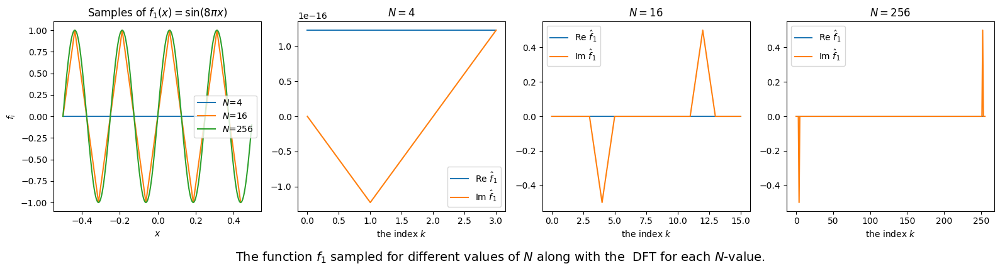

In [5]:
experiment(f1, N)

Here the approximation is terrible for $N=4$ as we land exactly at zeros of $f_1$. For greater $N$ it is good as we hit the peaks and valleys as well.

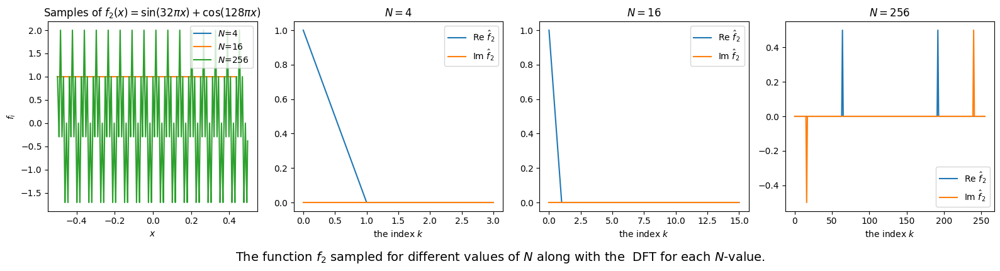

In [6]:
experiment(f2, N)

Here the approximation is good once we hit $N=256$. For the low $N$-values we are unlucky with the period and get points from the peaks.

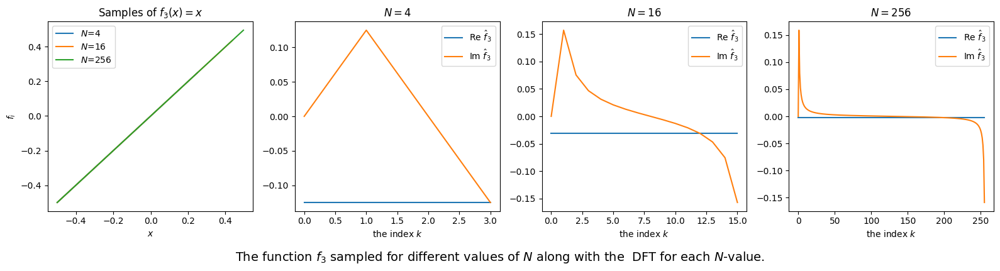

In [7]:
experiment(f3, N)

The approximation is good for any $N$.

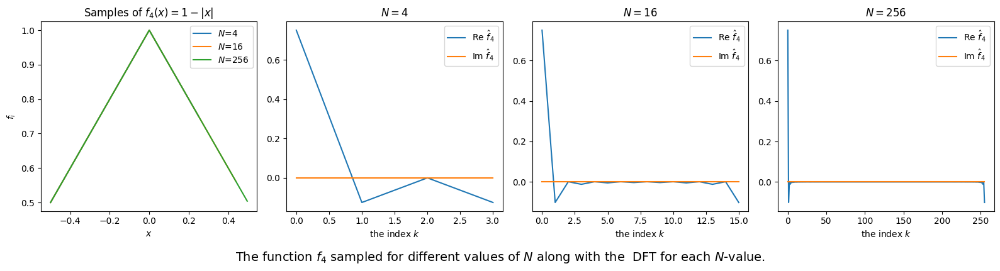

In [8]:
experiment(f4, N)

The approximation is good for any $N$.

### 1i) 

We consider again $f_2(x) = \sin(32\pi x) + \cos(128\pi x)$. We immidiatelly see that:

$$
\begin{align*}
a_{64} &= b_{16} = \frac{1}{\sqrt{2}}, \\ 
a_i &= b_j = 0, \textrm{ otherwise}. 
\end{align*}
$$

We can also rewrite to find the $c_k$'s:

$$
\begin{align*}

f_2(x) &= \sin(32\pi x) + \cos(128\pi x) \\

    &= \frac{e^{16\cdot 2\pi i x}-e^{-16\cdot 2\pi i x}}{2i} + 
    \frac{e^{64\cdot 2\pi i x}+e^{-64\cdot 2\pi i x}}{2}.

\end{align*}
$$

From which we see:

$$
\begin{align*}
c_{16} &= -  c_{-16} = \frac{1}{2i}, \\
c_{64} &=  c_{-64} = \frac{1}{2}, \\ 
c_i &= 0, \textrm{ otherwise}. 
\end{align*}
$$


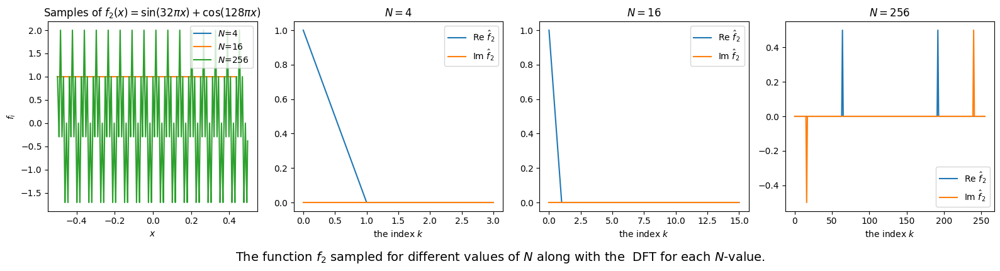

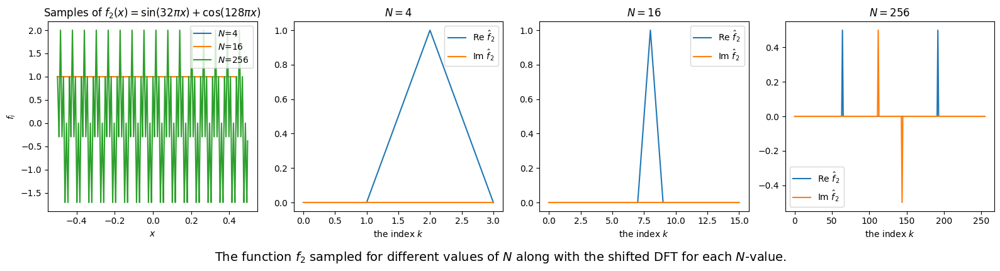

In [9]:
experiment(f2, N, fftshift=False)
experiment(f2, N, fftshift=True)

We see that the function $\textrm{sc.fft.fftshift(x)}$ moves the zero-frequency component to the middle. 

We now want to remove the summand $\cos(128\pi x)$ by modifying in the frequency space. We know from the previous discussion using Euler that this term corresponds to $c_{\pm64}$:

C:\Users\Trond\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\matplotlib\cbook\__init__.py:1369: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


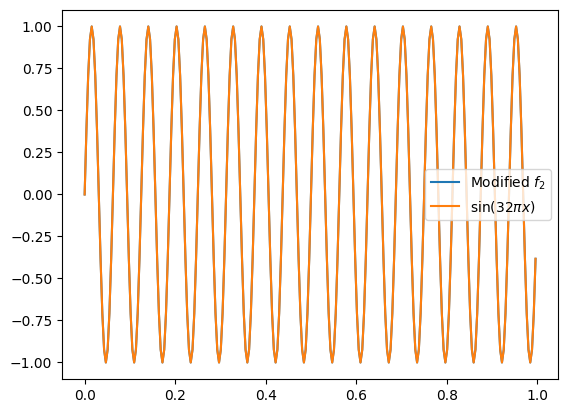

In [10]:
# Sample f2 with N = 256
N = 256
x, f_vals = transform(f2["function"], N)

# Compute DFT, shift frequencies and set +-64 to +0
shifted = DFT(f_vals, fftshift=True, div_by_N=False) # Scipy prefers not dividing by N ...
shifted[N//2 + 64] = 0
shifted[N//2 - 64] = 0

# Shift back and compute inverse
unshift = sc.fft.ifftshift(shifted)
inverse = sc.fft.ifft(unshift)

# Make plot
plt.plot(x, inverse, label = r"Modified $f_2$")
plt.plot(x, np.sin(32*np.pi*x), label = "$\sin(32\pi x)$")
plt.legend()
plt.show()

We cannot do the same for $N < 64$ since then we don't have access to the terms corresponding to the cosine term. In this case, features originating from this term will get spread into the other coefficients.

## Task 2 - Signal Processing

In this task we study signall processing. We write signals as vectors $\boldsymbol{a}=(a_0,\dots,a_{N-1})\in\mathbb{R}^N$, and want to work with them in the frequency domain as $\hat{\boldsymbol{a}}=\frac{1}{N}\mathcal{F}_N\boldsymbol{a}$.

We will consider the signals as samples from a periodic functions. The (periodic) convolution is given by:

$$
    (f * g) (x) = \int_\mathbb{T} f(y)g(x-y)dx = \int_0^1 f(y)g(x-y)dy.
$$

For our signal $\boldsymbol{a}$ the *cyclic convolution* of $\boldsymbol{a}, \boldsymbol{b}$ is given by:

$$
    (\boldsymbol{a}*\boldsymbol{b})_j = \sum_{k=0}^{N-1}a_k b_{j-k \mod N}.
$$

For an input $\boldsymbol{a}$, if $\boldsymbol{b}$ is used to modify $\boldsymbol{a}$ with convolution, we refer to $\boldsymbol{b}$ as a *filter* and say that the convolution "filters a signal".     

### 2a)

**Question:** What happens to $\boldsymbol{c}=\boldsymbol{a}*\boldsymbol{b}$ if we instead use a shifted $\boldsymbol{b}' = (b_{N-1}, b_0, \dots, b_{N-2})$?

**Answer:**

We begin by noting that the $n$'th component of $\boldsymbol{b}$ corresponds to the $(n+1)$'th component (modulo $N$) of $\boldsymbol{b}'$. With this we compute:

$$
    \boldsymbol{c}'_j 
    = (\boldsymbol{a}*\boldsymbol{b}')_j 
    = \sum_{k=0}^{N-1}a_k b'_{j-k \mod N} 
    = \sum_{k=0}^{N-1}a_k b_{j-k-1 \mod N}.
$$

This shows that the weights from $\boldsymbol{b}$ in the convolution gets shifted. 

For a simple / extreme example consider: 

$$
    b_j 
    = \begin{cases}
    1 & \textrm{if } j = 0 \\
    0 & \textrm{if } j \ne 0
    \end{cases},

    \quad

    b_j' 
    = \begin{cases}
    1 & \textrm{if } j = 1 \\
    0 & \textrm{if } j \ne 1
    \end{cases}.
$$

In this case we get, for instance:

$$
\begin{align*}
    c_0 &= a_0, \quad 
    c_0' = a_{N-1}, \\

    c_1 &= a_1, \quad
    c_1  = a_0\dots

\end{align*}
$$

### 2b)

**Claim:** For $f,g\in L_1(\mathbb{T})$ we have:

$$
    \forall k \in \mathbb{Z} \quad c_k(f*g) = c_k(f)c_k(g).
$$

**Proof:** 

We compute:

$$
\begin{align*}
    c_k(f*g)
    &= \int_0^1 (f*g)(x) e^{-2\pi i k x} dx \\
    &= \int_0^1 \int_0^1 f(y)g(x-y) dy e^{-2\pi i k x} dx \\
    &= \int_0^1 \int_0^1 f(y)g(x-y) e^{-2\pi i k x} dy  dx \\
    &= \int_0^1 e^{-2\pi i k y}f(y)\int_0^1 g(x-y) e^{-2\pi i k (x-y)} dx  dy \\
    &= \int_0^1 e^{-2\pi i k y}f(y) \overset{c_k(g)}{\overbrace{\int_{-y}^{1-y} g(u) e^{-2\pi i k (u)} du}}  dy \\
    &= c_k(g)\cdot \int_0^1 e^{-2\pi i k y}f(y) dy \\
    &= c_k(f)c_k(g).
\end{align*}
$$

In the text above the integral after the third last equality we use the periodicity of $g$ and $e^{2\pi i k (u)}$ to recognise this as the $k$'th Fourier coefficient of $g$.

<div style="text-align: right"> ▢ </div>

**Claim:** For signals we similarly have:

$$
    \widehat{\boldsymbol{a}*\boldsymbol{b}} = \hat{\boldsymbol{a}} \circ \hat{\boldsymbol{b}}
$$

**Proof:** We compute for any component $k$:

$$
\begin{align*}
    (\widehat{\boldsymbol{a}*\boldsymbol{b}})_k 

    &= \sum_{j=0}^{N-1} (\boldsymbol{a}*\boldsymbol{b})_j e^{-2\pi i j k / N }\\

    &= \sum_{j=0}^{N-1} \sum_{l=0}^{N-1}a_l b_{j-l \mod N} e^{-2\pi i j k / N }\\

    &= \sum_{l=0}^{N-1} \left( a_l e^{-2\pi i l k / N } 
            \sum_{j=0}^{N-1} b_{j-l \mod N} e^{-2\pi i (j-l) k / N } \right)\\

    &= \sum_{l=0}^{N-1} \left( a_l e^{-2\pi i l k / N } 
        \overset{\hat{\boldsymbol{b}}}{\overbrace{\sum_{j=0}^{N-1} b_{j-l \mod N} e^{-2\pi i (j-l\mod N) k / N }}} 
        \overset{1}{\overbrace{e^{-2\pi i k MN  / N }}} \right)\\

    &= \hat{b}_k \sum_{l=0}^{N-1} a_l e^{-2\pi i l k / N } 
        \\

    &= \hat{a}_k\hat{b}_k

\end{align*}
$$

After the fourth equality we draw out $MN$ from $j-l$ to get the remainder $j-l \mod N$. What remains in the sum then corresponds exactly to each term in the sum for $\hat{b}_k$. 

Since this computation holds for all components, we have the desired result.

<div style="text-align: right"> ▢ </div>

**Question:** *How does this help with / simply the computation of $(\textrm{circ }\boldsymbol{a})(\textrm{circ }\boldsymbol{b})$?*

**Claim:** $(\textrm{circ }\boldsymbol{a})(\textrm{circ }\boldsymbol{b}) = \textrm{circ }\boldsymbol({a*b}).$

**Proof:** This proof is inspired by the proof on p. 140 of TODO CITE

TODO



<div style="text-align: right"> ▢ </div>


### 2c)

We consider the Dirichlet kernel

$$
    D_n(x) = 1 + 2 \sum_{j=1}^{n} \cos(2\pi j x), \quad n\in \mathbb{N}.
$$

We compute the Fourier coefficients. If $k = 0$ we get:

$$
\begin{align*}
    c_0(D_n) 
    &= \int_0^1 D_n(x) dx 

    &= \int_0^1 1 dx + 2 \sum_{j=1}^{n}\int_0^1  \cos(2\pi j x)dx 

    &= 1 + 0 = 1.
\end{align*}
$$

Before computing $c_k(D_n)$ we consider the following integral for $k\in\mathbb{Z}\setminus \{0\}, j\in \mathbb{N}\setminus{0}$:

$$
\begin{align*}
    I(j, k) 
    &= \int_0^1  \cos(2\pi j x) e^{-2\pi i k x} dx \\
    &= \frac{1}{2\pi}\int_0^{2\pi}  \cos(j x) (\cos(k x) - i \sin(k x)) dx \\
    &= \frac{1}{2\pi}\int_0^{2\pi}  \cos(j x) \cos(k x) - i \cos(j x)\sin(k x) dx \\
    &= \frac{1}{4\pi}\int_0^{2\pi}  \cos((j-k) x) + \cos((j+k) x) - i(-\sin((j-k)x)+\sin((j+k)x)) dx \\
    &= 
    \frac{1}{4\pi}\left(\begin{cases} 
        2\pi & j=k \\ 0 & j\ne k
    \end{cases}
    +\begin{cases} 
        2\pi & j=-k \\ 0 & j\ne -k
    \end{cases} + 0 + 0\right)
    = \begin{cases} 
        \frac{1}{2} & j=\pm k \\ 0 & j\ne \pm k
    \end{cases}.
\end{align*}
$$

Where the integrals of $\sin$ vanish in all cases (we either integrate $0$ or we integrate sine over a multiple of its period.). Assume now $k\ne 0$. We find:

$$
\begin{align*}
    c_k(D_n) 

    &= \int_0^1 \left( 1  + 2 \sum_{j=1}^{n} \cos(2\pi j x)  \right)e^{-2\pi i k x} dx\\

    &= \int_0^1 e^{-2\pi i k x} dx + 2 \sum_{j=1}^{n} I(j,k)\\

    &= 0 + 2 \sum_{j=1}^{n} 
    \begin{cases} 
        \frac{1}{2} & j=\pm k \\ 0 & j\ne \pm k
    \end{cases} \\

    &=  
    \begin{cases} 
        1 & |k|\in\{1,2,\dots,n\} \\ 0 & \textrm{else.}
    \end{cases} \\

\end{align*}
$$

In conclusion:

$$
    c_k(D_n) = 
    \begin{cases} 
        1 & |k|\in\{0,1,\dots,n\} \\ 0 & \textrm{else.}
    \end{cases} \\
$$


**Question:** Dirichlet kernel as a filter.

Assume now we that we have equidistant samples and that we want to use $d_j \overset{\textrm{def}}{=}D_n(\frac{j}{N}), j=0,\dots,N-1$ as a filter. Since $c_k(D_n)\approx\hat{d}_k$, it is a easier to define 

$$
    \hat d_k = 
    \begin{cases} 
        1 & |k|\in\{0,1,\dots,n\} \\ 0 & \textrm{else,}
    \end{cases} \\
$$

directly than to compute the transform. As a filter, we can interpret $\hat{\boldsymbol{d}}$ as removing all frequencies outside $\{-2\pi k, \dots2\pi k\}$. To use the filter on $f$ we compute convolution by visiting the frequency domain: 

$$
    f_{\textrm{filtered}} 
    
    = \boldsymbol{f} * \boldsymbol{d} 
    
    = \mathcal{F}_N^{-1} (\widehat{\boldsymbol{f} * \boldsymbol{d}})

    = \mathcal{F}_N^{-1} (\hat{\boldsymbol{f}} \circ \hat{\boldsymbol{d}}).
$$

### 2d)

We sample $f_2$ with $N=512$ samples. 



In [12]:
# Define D_n(x)
Dn = lambda x, n : 0*x + 1 + 2*sum([np.cos(2*np.pi*k*x) for k in range(0, n)]) # 0*x ensures right shape when n = 0

# Define the convolution we want
def naive_convolve(a, b):
    """
    Returns the cyclic convolution of a, b defined as:
    (a*b)_j = sum_{k=0}^{N-1} a_{k}b_{j-k  mod N}
    """
    N = len(a)
    convolution = np.zeros(N)

    for j in range(N):
        convolution[j] = sum([a[k]*b[(j-k) % N] for k in range(N)])

    return convolution

def convolve(a, b):

    return sc.fft.ifft(sc.fft.fft(a)*sc.fft.fft(b))


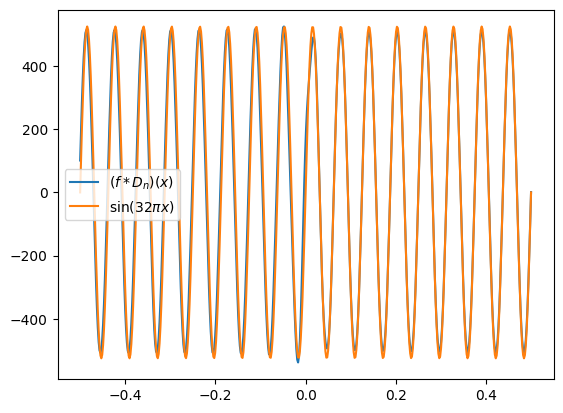

In [13]:
# Take 512 samples
n = 512
samples = np.linspace(-0.5, 0.5, n)
f2_samples = f2["function"](samples)
Dn_samples = Dn(samples, 48)

# Compute
naive_convolution = convolve(f2_samples, Dn_samples)
convolution = convolve(f2_samples, Dn_samples)

# Plot the convolution
plt.plot(samples, convolution, label = r"$(f*D_n)(x)$")
plt.plot(samples, np.sin(32*np.pi*samples)*max(convolution), label = r"$\sin(32\pi x)$")
plt.legend()
plt.show()

We see that convolving with $D_{48}$ filters out the high frequency term.

In the cell below we demonstrade the formula shown in problem b). This is why we could define the function concolution, which is faster than the nainve convolution and gives the same result.

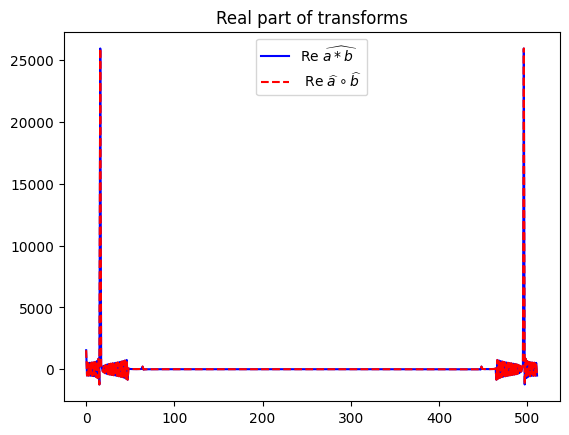

In [14]:
# Compute the DFT in two ways

transformed_convolution = DFT(naive_convolution, div_by_N=False).real
product_of_transformed  = (DFT(f2_samples, div_by_N=False)*DFT(Dn_samples, div_by_N=False)).real

plt.plot(transformed_convolution, "b",   label = r"Re $\widehat{a*b}$")
plt.plot(product_of_transformed,  "r--", label = r" Re $\widehat{a}\circ \widehat{b}$")
plt.legend()
plt.title("Real part of transforms")
plt.show()


### 2e)

We now read a signal from file and convolve with two kernels.

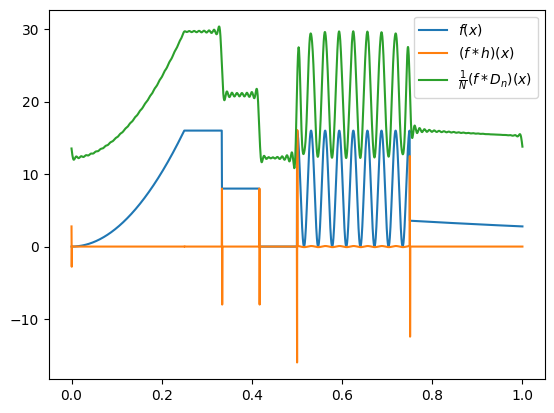

In [16]:
import csv

# We read the data from file
file_path = 'project1-data/project1-1e-data.csv'

x_values, signal_values = [], []

with open(file_path, newline='') as csvfile:
    reader = csv.DictReader(csvfile)
    
    for row in reader:
        x_values.append(float(row['x']))
        signal_values.append(float(row['signal']))

x_values, signal_values = np.array(x_values), np.array(signal_values)

# Define filter h
def h(N):
    """
    Returns [-1, 2, -1, 0, 0, 0, ..., 0] with given length N>=3
    """
    return np.array([-1., 2., -1.] + list(np.zeros(N-3)))


# Compute the two filtered variants
N = len(x_values)
h_filtered  = convolve(signal_values, h(N))
Dn_filtered = convolve(signal_values, Dn(x_values, 92))

plt.plot(x_values, signal_values, label = r"$f(x)$")
plt.plot(x_values, h_filtered, label = r"$(f*h)(x)$")
plt.plot(x_values, 1/N * Dn_filtered, label = r"$\frac{1}{N}(f*D_n)(x)$")
plt.legend()
plt.show()

### 2f)

We have seen that as a filter, $D_n$ "picks out" the frequencies $0, 2\pi, 4\pi, \dots, n2\pi$. The opposite would "remove" these frequencies. 

frequencies in 0, ..., n  = Dn * f

frequencies not in 0, ..., n = f - Dn * f

### 2g)

If we want to pick out the frequencies $c_k(f)$ for for instance $40\leq |k| \leq 64$, we can compute $f$ filtered TODO

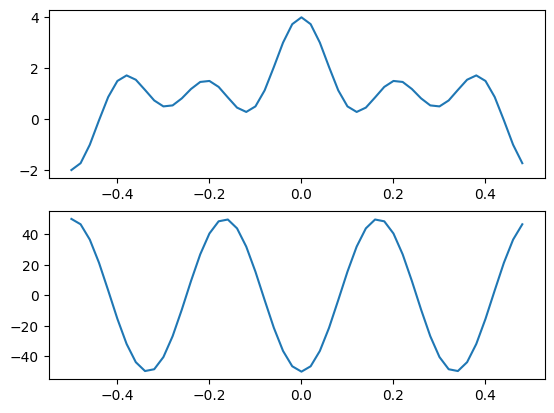

In [17]:
def filter_freq(x, y, k0, k1):
    

    return convolve(y, Dn(x, k1)) - convolve(y, Dn(x, k0-1))

f5 = lambda x : 1 + np.cos(2*np.pi*x) + np.cos(3*2*np.pi*x) + np.cos(5*2*np.pi*x)

x_values = np.linspace(-0.5, 0.5, 50, endpoint=False)
y_values = f5(x_values)

fig, ax = plt.subplots(2, 1)
ax[0].plot(x_values, y_values)
ax[1].plot(x_values, filter_freq(x_values, y_values, 3, 4))
plt.show()

## Task 3 - Image Processing

In this task we consider

$$f:\mathbb{T}^2\rightarrow\mathbb{C},$$

i.e. functions that are $T=1$-periodic in both arguments. We sample points $x_{j_1, j_2} = (\frac{j_1}{N_1}, \frac{j_2}{N_2}), j_i = 0, \dots, N_i-1$. This gives the sampled *image* $F=\left( f(x_{j_1, j_2}) \right)_{j_1, j_2 = 0}^{N_1-1, N_2-1}\in \mathbb{R}^{N_1\times N_2}$. We consider each entry a *pixel* when it takes a values in $[0,1]$ (black, white). 

We define the multivariate Fourier transform as:

$$
\begin{equation}
    \hat{F}_{k_1, k_2} \overset{\textrm{def}}{=} \sum_{j_1 = 0}^{N_1 -1}\sum_{j_2 = 0}^{N_2 -1}
    F_{j_1, j_2} e^{-2\pi i (j_1 k_1 / N_1 + j_2 k_2 / N_2)},
    \quad k_i = 0,\dots N_i-1.
\end{equation}
$$

### 3a)

**Claim:** Equation (1) can be computed in $\mathcal{O}(N_1N_2\log(N_1N_2))$. 

**Proof:**

Recall that the 1D Fourier transform can be computed in $\mathcal{O}(N)$. Write:

$$
\begin{align*}
\hat{F}_{k_1, k_2} 
    &= \sum_{j_1 = 0}^{N_1 -1}\sum_{j_2 = 0}^{N_2 -1}
    F_{j_1, j_2} e^{-2\pi i (j_1 k_1 / N_1 + j_2 k_2 / N_2)} \\

    &= \sum_{j_1 = 0}^{N_1 -1} \left( e^{-2\pi i j_1 k_1 / N_1} 
    % \overset{\textrm{Computed for every } k_2 \textrm{ in }\mathcal{O}(N_2\log(N_2))}
    \overset{G(j_1, k_2)}
    {\overbrace{
    \sum_{j_2 = 0}^{N_2 -1} F_{j_1, j_2} e^{-2\pi i j_2 k_2 / N_2}  
    }}\right) \\
    
    &= \sum_{j_1 = 0}^{N_1 -1} e^{-2\pi i j_1 k_1 / N_1} G(j_1, k_2) \\

\end{align*}
$$

We notice that for fixed $j_1$, computing $G(j_1, k_2)$ for each $k_2=0, \dots, N_2-1$, corresponds to a 1D FFT with runtime complexity $\mathcal{O}(N_2 \log (N_2))$. Doing it for each $j_1$ then gives $\mathcal{O}(N_1 N_2 \log (N_2))$. 

Finally for a fixed $k_2$, computing the final sum for each $k_1$ is done by another FFT with runtime complexity $\mathcal{O}(N_1 \log (N_1))$. Again, doing it for all $k_2$ gives $\mathcal{O}(N_2 N_1 \log (N_1))$. In total we have done:

$$
    \mathcal{O}(N_1 N_2 \log (N_2)) + \mathcal{O}(N_2 N_1 \log (N_1)) = \mathcal{O}(N_1 N_2 \log (N_1) \log(N_2)).
$$

<div style="text-align: right"> ▢ </div>

### 3b)

We consider the function:

$$
    f(\boldsymbol{x}) = 1 + \frac{1}{2} \sin(2\pi \boldsymbol{x}^T\boldsymbol{k}), \quad \boldsymbol{x}\in[0,1]^2,
$$

for the three cases $\boldsymbol{k}\in\{(5,0)^T,(0,10)^T,(8,8)^T\}$. Note that the choice of values ensures $f(\boldsymbol{x})\in [0,1]$.

We note that this function takes values in $[0.5, 1.5]$, but we map this to $[0, 1]$ to get a grayscale image.

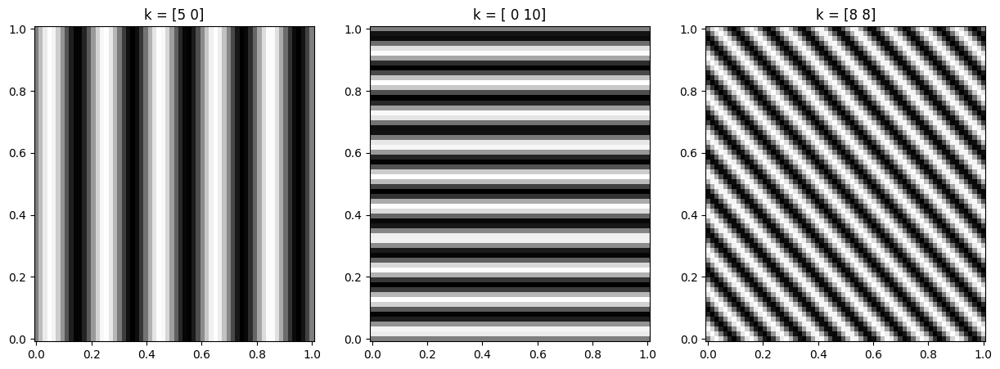

In [18]:
# Define function
def f(X, Y, k):
    return  1 + 1/2 * np.sin(2*np.pi*(X*k[0] + Y*k[1]))

k_vals = [np.array([5,0]), np.array([0,10]), np.array([8,8])]

# Initialise grid
N = 64
x_vals = np.linspace(0,1,N)
y_vals = np.linspace(0,1,N)
X, Y = np.meshgrid(x_vals, y_vals)

# Make plot of the functions
fig, ax = plt.subplots(1,3, figsize=(15, 5))
for i in range(3):
    f_vals = f(X, Y, k_vals[i]) - 0.5 # Map to [0,1]
    ax[i].pcolormesh(X, Y, f_vals, cmap='gray')
    ax[i].set_title(f"k = {k_vals[i]}")
plt.show()

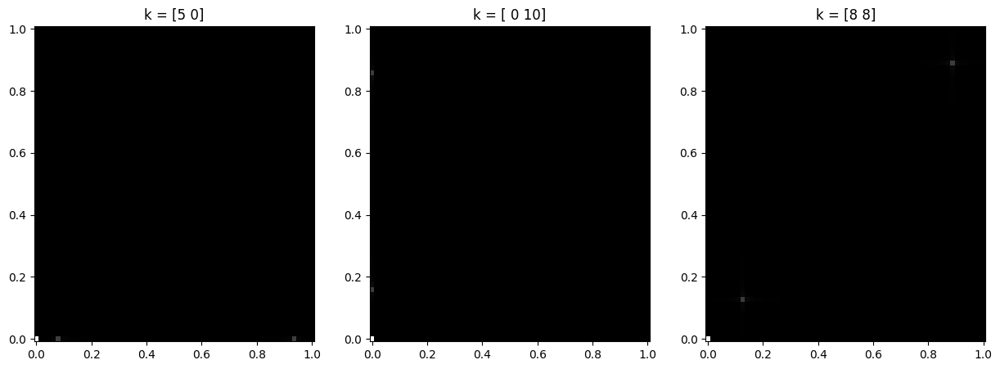

In [19]:
# Define 2D transform
def DFT_2D(F):
    return sc.fft.fft2(F)

def DFT_2D_inverse(F_hat):
    return sc.fft.ifft2(F_hat).real

# Make plot of the functions
fig, ax = plt.subplots(1,3, figsize=(15, 5))
for i in range(3):
    abs_DFT = np.abs(DFT_2D(f(X, Y, k_vals[i])))
    ax[i].pcolormesh(X, Y, abs_DFT, cmap='gray')
    ax[i].set_title(f"k = {k_vals[i]}")
plt.show()

### 3c)

We define the 2D Dirichlet kernel as:

$$
    D_{N_1, N_2} (x, y) = D_{N_1}(x)D_{N_2}(y).
$$

In the codeblock below we also define 5 matrices that we want to test as filters, namelly:

$$
    \begin{pmatrix}
    0 & -1 & 0 \\     -1 & 4 & -1 \\     0 & -1 & 0 \\
    \end{pmatrix}    ,\quad    \begin{pmatrix}
    -1 & 2 & -1 \\     -1 & 2 & -1 \\     -1 & 2 & -1 \\
    \end{pmatrix}    ,\quad    \begin{pmatrix}
    -1 & -1 & -1 \\     2 & 2 & 2 \\     -1 & -1 & -1 \\
    \end{pmatrix}    ,\quad    \begin{pmatrix}
    1 & 2 & 1 \\     0 & 0 & 0 \\     -1 & -2 & -1 \\
    \end{pmatrix}    ,\quad    \begin{pmatrix}
    1 & 0 & -1 \\     2 & 0 & -2 \\     1 & 0 & -1 \\
    \end{pmatrix}.
$$

We refer to these as $M_1, M_2, \dots, M_5$.

In [20]:
# Define 2D convolution
def convolve_2D(A, B):
    return DFT_2D_inverse(DFT_2D(A) * DFT_2D(B)) 

# Define the 2D Dirichlet kernel. This takes X and Y meshgrids as input
Dn2 = lambda X, Y, N1, N2 : Dn(X, N1)*Dn(Y, N2)

# Define the matrices
M1 = np.array([[0,-1,0],[-1,4,-1],[0,-1,0]]).T
M2 = np.array([[-1,2,-1],[-1,2,-1],[-1,2,-1]]).T
M3 = np.array([[-1,-1,-1],[2,2,2],[-1,-1,-1]]).T
M4 = np.array([[1,2,1],[0,0,0],[-1,-2,-1]]).T
M5 = np.array([[1,0,-1],[2,0,-2],[1,0,-1]]).T

# DN with N1=N2=64
N = 64
xy_vals = np.linspace(-0.5,0.5,N)
X, Y = np.meshgrid(xy_vals, xy_vals)
D64 = Dn2(X, Y, N, N)

# A function to pad a matrix with 0 to match the matrix N
def extend(M, N):
    """
        The shape of M must be <= to that of N in both dim
    """
    shape = N.shape
    extended = np.zeros(shape)
    extended[0:M.shape[0], 0:M.shape[1]] = M
    return extended

In [21]:
def convolution_experiment(image_paths, M, resolution = 30):
    
    # How many images, usually 1 or 2
    n = len(image_paths)

    # Set picture parameters
    figsize = (2*n*resolution, resolution)
    fontsize = 4 * resolution

    # Make figure
    fig, ax = plt.subplots(1, 2*n, figsize=figsize)


    for i in range(n):

        # Open the image, onvert the to NumPy array, take log
        image = Image.open(image_paths[i])
        image_array = np.array(image)

        # Extend M
        M = extend(M, image_array)

        ax[0+2*i].imshow(image_array, cmap = 'gray')
        ax[1+2*i].imshow(convolve_2D(image_array, M), cmap = 'gray')
        
        for j, title in enumerate(["Original", "New"]):
            ax[j+2*i].set_title(title, fontsize=fontsize)
            ax[j+2*i].set_xticks([])
            ax[j+2*i].set_yticks([])
    
    plt.tight_layout()
    plt.show()

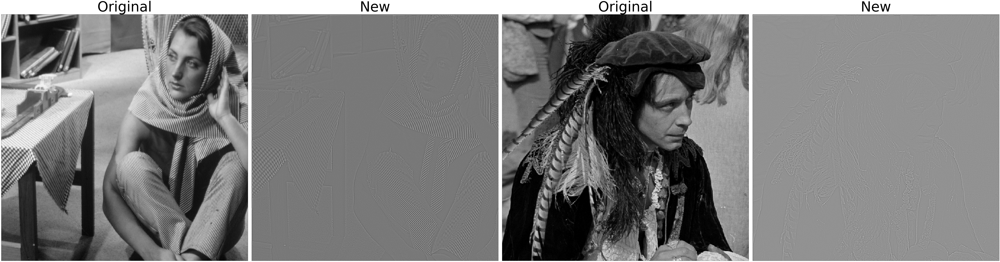

In [22]:
convolution_experiment(['project1-data/barbara.gif', 'project1-data/klaus.gif'], M1)

$$
    M_1 = 
    \begin{pmatrix}
    0 & -1 & 0 \\     -1 & 4 & -1 \\     0 & -1 & 0 \\
    \end{pmatrix}
$$

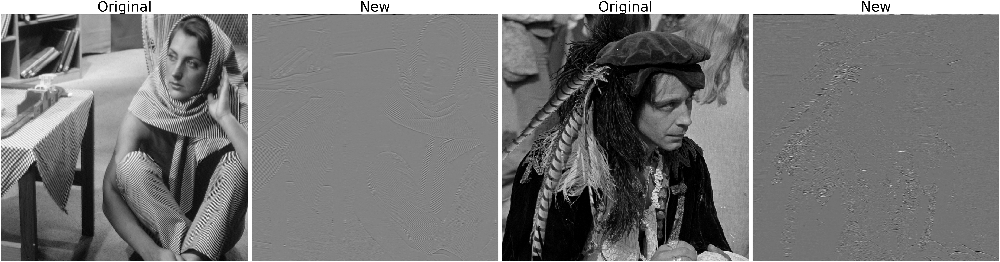

In [23]:
convolution_experiment(['project1-data/barbara.gif', 'project1-data/klaus.gif'], M2)

$$
    M_2 = 
    \begin{pmatrix}
    -1 & 2 & -1 \\     -1 & 2 & -1 \\     -1 & 2 & -1 \\
    \end{pmatrix}
$$

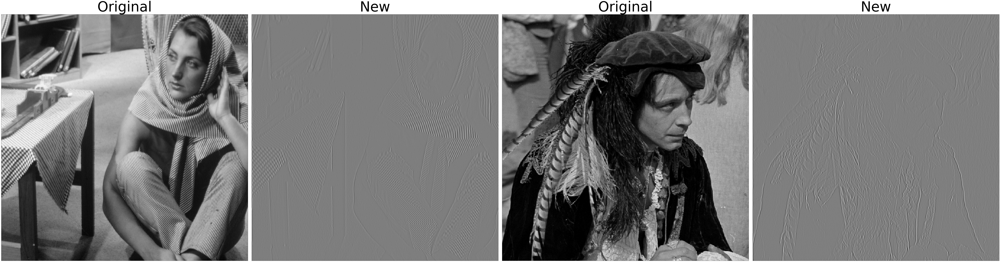

In [24]:
convolution_experiment(['project1-data/barbara.gif', 'project1-data/klaus.gif'], M3)

$$
    M_3 = 
    \begin{pmatrix}
    -1 & -1 & -1 \\     2 & 2 & 2 \\     -1 & -1 & -1 \\
    \end{pmatrix}
$$

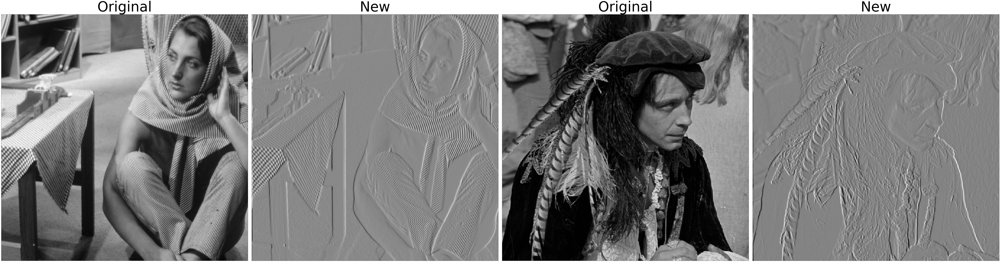

In [25]:
convolution_experiment(['project1-data/barbara.gif', 'project1-data/klaus.gif'], M4)

$$
    M_4 = 
    \begin{pmatrix}
    1 & 2 & 1 \\     0 & 0 & 0 \\     -1 & -2 & -1 \\
    \end{pmatrix}
$$

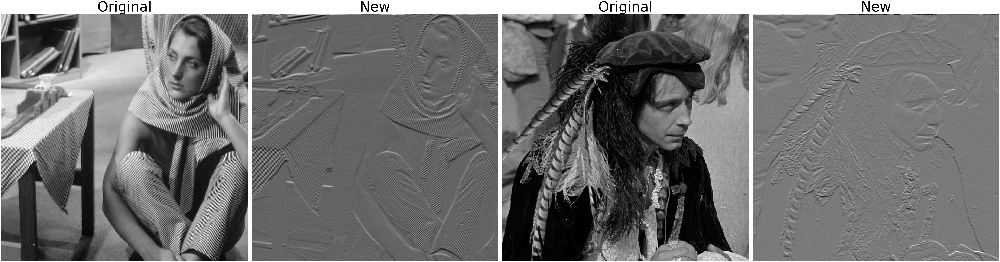

In [26]:
convolution_experiment(['project1-data/barbara.gif', 'project1-data/klaus.gif'], M5)

$$
    M_5 = 
    \begin{pmatrix}
    1 & 0 & -1 \\     2 & 0 & -2 \\     1 & 0 & -1 \\
    \end{pmatrix}.
$$

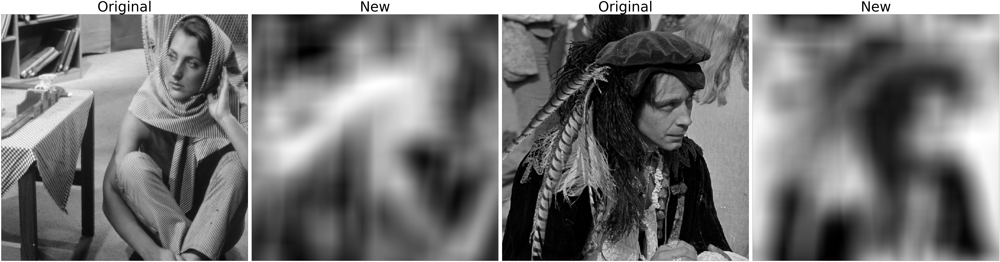

In [27]:
convolution_experiment(['project1-data/barbara.gif', 'project1-data/klaus.gif'], D64)

Removing high frequencies results in less detail giving a blurred effect.

### 3d)

My initial strategy to remove dot artefacts from images was to pick out the frequencies and remove them. I started by the below and experimented with removing different frequencies without much success.

C:\Users\Trond\AppData\Local\Temp\ipykernel_27784\3123749740.py:19: RuntimeWarning: divide by zero encountered in log
  ax[0].imshow(np.log(image_array   ),    cmap = 'gray')


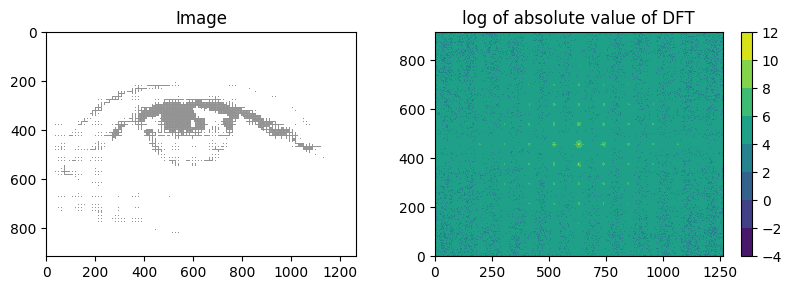

In [28]:
def DFT_of_image(image_path, resolution=3):
    
    # Set picture parameters
    figsize = (2.8*resolution, resolution)
    fontsize = 4 * resolution

    # Open the image, onvert the to NumPy array, take log
    image = Image.open(image_path)
    image_array = np.array(image) / 255

    # Transform and shift
    dft = DFT_2D(image_array)
    dft = sc.fft.fftshift(dft)

    # Make figure
    fig, ax = plt.subplots(1, 2, figsize=figsize)

    # Make plot
    ax[0].imshow(np.log(image_array   ),    cmap = 'gray')
    ax[0].set_title("Image", fontsize=fontsize)

    cont = ax[1].contourf(np.log(np.abs(dft)))
    ax[1].set_title("log of absolute value of DFT", fontsize=fontsize)
    plt.colorbar(cont)
    
    plt.tight_layout()
    plt.show()


DFT_of_image('project1-data/Yarimton-dithered.png')

C:\Users\Trond\AppData\Local\Temp\ipykernel_27784\3732965456.py:11: RuntimeWarning: divide by zero encountered in log
  ax[0].imshow(np.log(image_array   ),    cmap = 'gray')
C:\Users\Trond\AppData\Local\Temp\ipykernel_27784\3732965456.py:12: RuntimeWarning: divide by zero encountered in log
  ax[1].imshow(np.log(image_filtered),    cmap = 'gray')


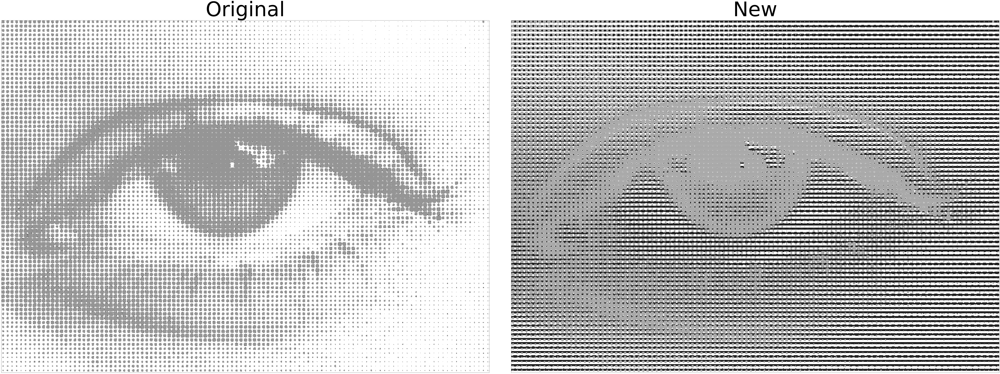

In [29]:
# Plot at potentially high resolution. Take log first.
def plot_comparison(image_array, image_filtered, resolution):
    # Set picture parameters
    figsize = (2.8*resolution, resolution)
    fontsize = 4 * resolution

    # Make figure
    fig, ax = plt.subplots(1, 2, figsize=figsize)

    # Make plot
    ax[0].imshow(np.log(image_array   ),    cmap = 'gray')
    ax[1].imshow(np.log(image_filtered),    cmap = 'gray')
    
    # Tidy up
    for i, title in enumerate(["Original", "New"]):
        ax[i].set_title(title, fontsize=fontsize)
        ax[i].set(xticks = [], yticks = [])
    
    plt.tight_layout()
    plt.show()

# Processing before plotting
def pre_plot_processing(image_array, image_filtered):
    # Add in some zeros to avoid issues with log, scale
    image_filtered[image_filtered < 10**(-4)] = 0
    image_array    = image_array / np.max(image_array)
    image_filtered = image_filtered / np.max(image_filtered)

    # Do some rounding
    image_array    = np.round(image_array, 3)
    image_filtered = np.round(image_filtered, 3)
    return image_array, image_filtered

def frequency_removal(image_path,  x_freq = [80], y_freq = [80], resolution=40):
    
    # Open the image, onvert the to NumPy array, take log
    image = Image.open(image_path)
    image_array = np.array(image) / 255

    # Transform and shift
    dft = DFT_2D(image_array)
    dft = sc.fft.fftshift(dft)

    # Remove requested frequencies
    x_C = dft.shape[1] // 2
    y_C = dft.shape[0] // 2

    new_val = 0
    for fx in x_freq:
        dft[y_C, x_C + fx] = new_val
        dft[y_C, x_C - fx] = new_val

    for fy in y_freq:
        dft[y_C + fy, x_C] = new_val
        dft[y_C - fy, x_C] = new_val

    # Shift back and inverse transform
    dft = sc.fft.ifftshift(dft)    
    image_filtered = DFT_2D_inverse(dft)
    
    image_array, image_filtered = pre_plot_processing(image_array, image_filtered)
    plot_comparison(image_array, image_filtered, resolution)

frequency_removal('project1-data/Yarimton-dithered.png', x_freq = [80], y_freq = [80])

Even though I sort of locate the correct freqencies, I don't get the results I want. (I tested many more than the one shown above...)

Then I did some research and found that Gaussian filters is a common way to blur out noise. 

In [30]:
# The Gaussian filter
def gaussian_filter(rows, cols, tresh):
    r_C = rows // 2 # Centre row
    c_C = cols // 2 # Centre column
    mask = np.ones((rows, cols), dtype=np.float32) # Initialise the filter
    
    # Insert values for Gaussian
    for i in range(rows):
        for j in range(cols):
            distance = np.sqrt((i - r_C) ** 2 + (j - c_C) ** 2)
            mask[i, j] = np.exp(-0.5 * (distance / tresh) ** 2)

    return mask


def dot_removal(image_path, tresh = 100, resolution=40):
        # Open the image, onvert the to NumPy array, take log
    image = Image.open(image_path)
    image_array = np.array(image) / 255

    # Transform and shift
    dft = DFT_2D(image_array)
    dft = sc.fft.fftshift(dft)

    # Create a Gaussian filter
    rows, cols = dft.shape
    filter = gaussian_filter(rows, cols, tresh)

    # Apply the filter to the frequency domain representation
    dft = dft * filter

    # Shift back and inverse transform
    dft = sc.fft.ifftshift(dft)    
    image_filtered = DFT_2D_inverse(dft)

    # Process and plot
    image_array, image_filtered = pre_plot_processing(image_array, image_filtered)
    plot_comparison(image_array, image_filtered, resolution)


In the cell below I have found tresholds that give very nice results for the lighthouse and munkholmen:

C:\Users\Trond\AppData\Local\Temp\ipykernel_27784\3732965456.py:11: RuntimeWarning: divide by zero encountered in log
  ax[0].imshow(np.log(image_array   ),    cmap = 'gray')


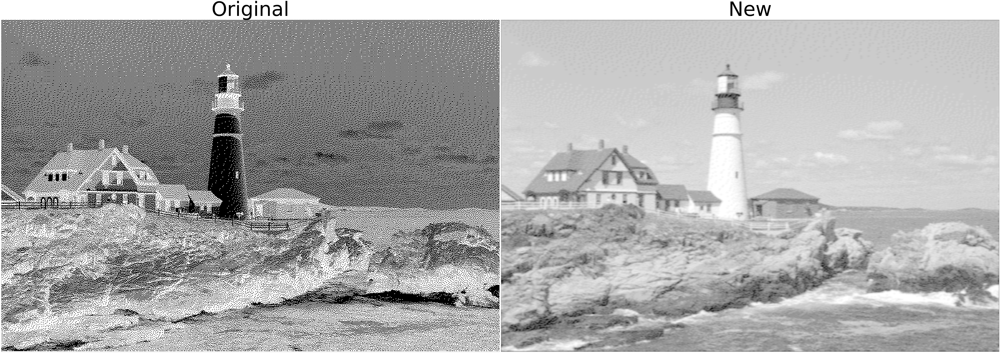

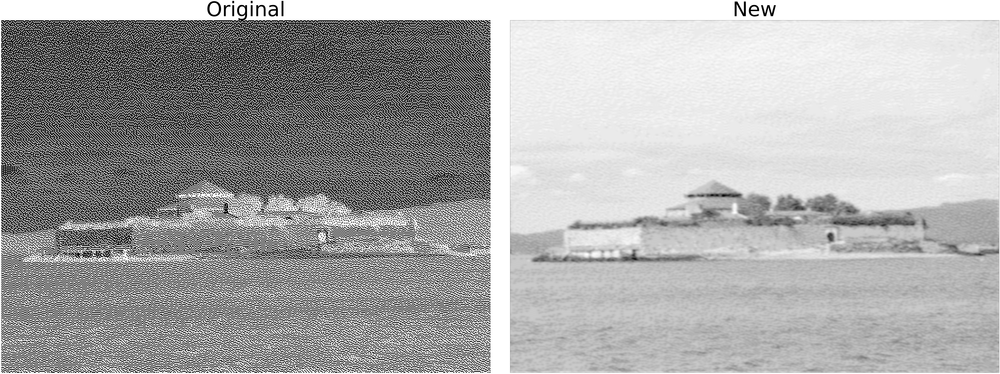

In [31]:
dot_removal('project1-data/lighthouse-dithered.png', tresh = 80)
dot_removal('project1-data/munkholmen-dithered.png', tresh = 60)

The results for the eye are not as nice, which Is not very surprising as the noise is of much lower frequency and hence harder tor remove while keeping detail.

C:\Users\Trond\AppData\Local\Temp\ipykernel_27784\3732965456.py:11: RuntimeWarning: divide by zero encountered in log
  ax[0].imshow(np.log(image_array   ),    cmap = 'gray')


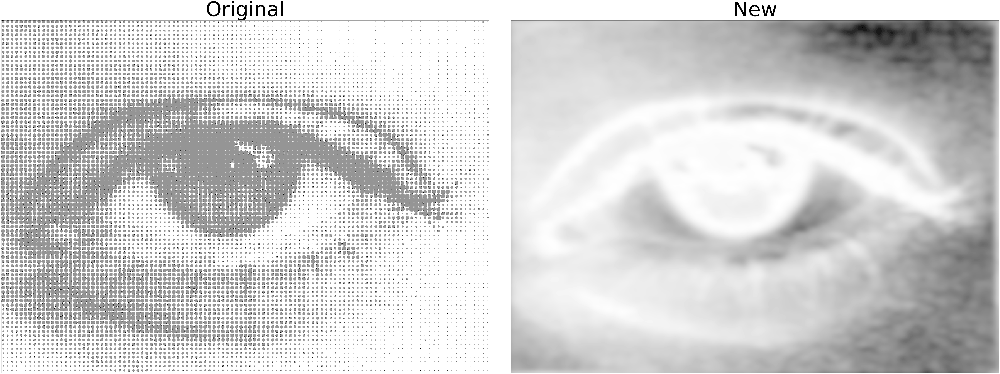

In [32]:
dot_removal('project1-data/Yarimton-dithered.png',   tresh = 20)

# Bibliography

https://link.springer.com/book/10.1007/978-3-030-04306-3

